In [29]:

import matplotlib.pyplot as plt
import pyarrow as pa
import pyarrow.parquet as pq
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
import json

In [30]:


# Replace 'your_file.geojson' with the path to your GeoJSON file
with open('NYC Taxi Zones.geojson', 'r') as f:
    geo_json_data = json.load(f)

# # Load the GeoJSON file
# geo_json_data = open('NYC Taxi Zones.geojson', 'r').read()

# # Create a map centered at some location
# m = folium.Map(location=[40.693943, -73.985880], zoom_start=12)

# # Add the GeoJSON layer to the map
# folium.GeoJson(geo_json_data).add_to(m)

# # Display the map
# m

In [31]:
# Step 1: Load the GeoJSON file
geojson_file = 'NYC Taxi Zones.geojson'
data = gpd.read_file(geojson_file)

# Step 2: Filter data for a specific borough
desired_borough = 'Manhattan'  # Replace with the desired borough name
filtered_data = data[data['borough'] == desired_borough]

# Step 3: Calculate the area of each polygon
filtered_data['area'] = filtered_data.geometry.area

# Exclude specific location ID (103 in this case)
filtered_data = filtered_data[filtered_data['location_id'] != '103']

# Step 4: Create a new GeoDataFrame with only location ID and area columns
geojson_data = filtered_data[['location_id', 'area']]

# Step 5: Save the GeoDataFrame as a new GeoJSON file
output_file = 'filtered_data.geojson'  # Provide the desired output file name
geojson_data = gpd.GeoDataFrame(geojson_data, geometry=filtered_data.geometry)
geojson_data.to_file(output_file, driver='GeoJSON')

/var/folders/6q/9wmlbvpj5nqfn_clctmzyck00000gn/T/ipykernel_3218/608470239.py:10: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  filtered_data['area'] = filtered_data.geometry.area
/Users/saoirse/miniconda3/envs/mayaisawesome/lib/python3.11/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [32]:
# Create the map
m = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

# Create a GeoJson object and add it to the map
g = folium.GeoJson(geo_json_data)

# Add a tooltip for the 'zone_number' attribute
tooltip = folium.GeoJsonTooltip(fields=['zone'])
g.add_child(tooltip)

# Add the GeoJson object to the map
g.add_to(m)

# Display the map
m

In [33]:
properties = geo_json_data['features'][0]['properties']
# print(properties.keys())

dict_keys(['shape_area', 'objectid', 'shape_leng', 'location_id', 'zone', 'borough'])


In [34]:
# # Create the map
# m = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

# # Create a GeoJson object and add it to the map
# g = folium.GeoJson(geo_json_data)

# # Add a tooltip for the 'zone_number' attribute
# tooltip = folium.GeoJsonTooltip(fields=['borough'])
# g.add_child(tooltip)

# # # Add the GeoJson object to the map
# # g.add_to(m)

# # # Display the map
# # m

In [35]:
# Create the map
%store -r location_images
m = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

# Filter the GeoJson features to only include Manhattan borough
filtered_features = [feature for feature in geo_json_data['features'] if feature['properties']['borough'] == 'Manhattan']
filtered_geo_json_data = {
    'type': 'FeatureCollection',
    'features': filtered_features
}

# Create a GeoJson object with the filtered data and add it to the map
g = folium.GeoJson(filtered_geo_json_data)

# Add a tooltip for the 'zone_number' attribute
tooltip1 = folium.GeoJsonTooltip(fields=['location_id'])
g.add_child(tooltip1)

# Add the GeoJson object to the map
g.add_to(m)

# Display the map
m


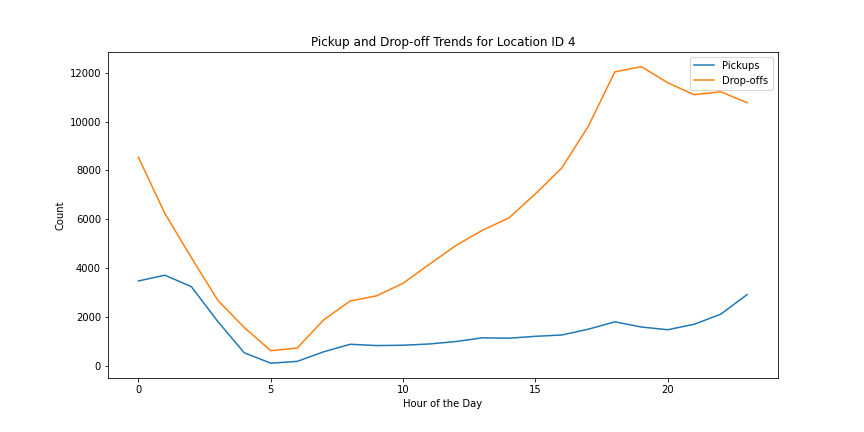
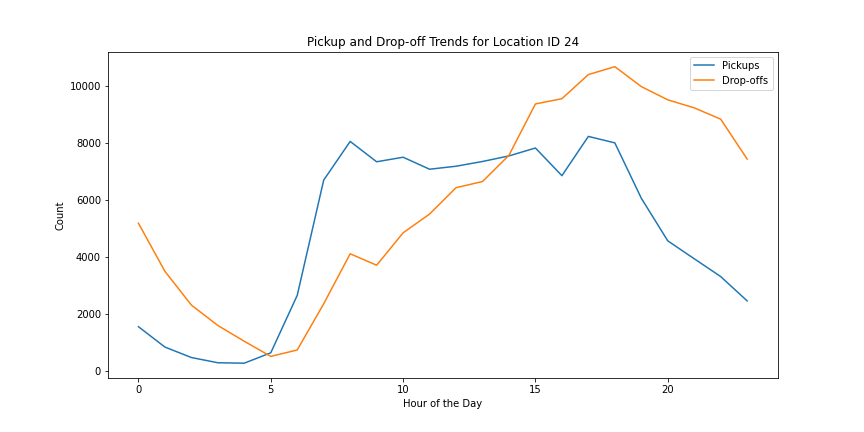
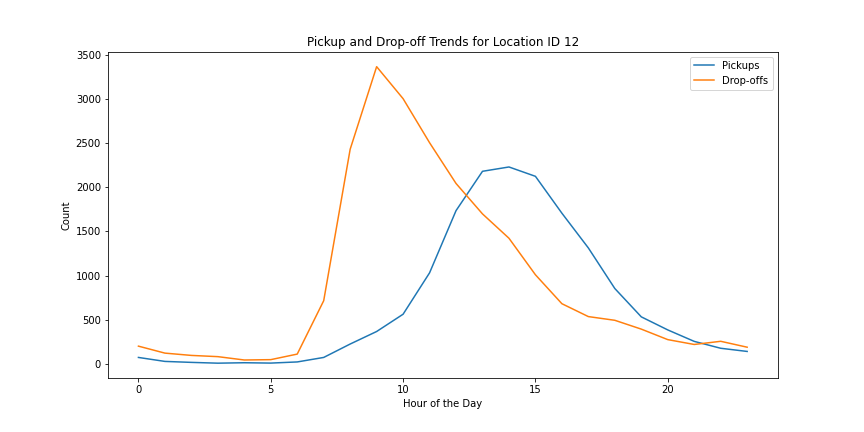
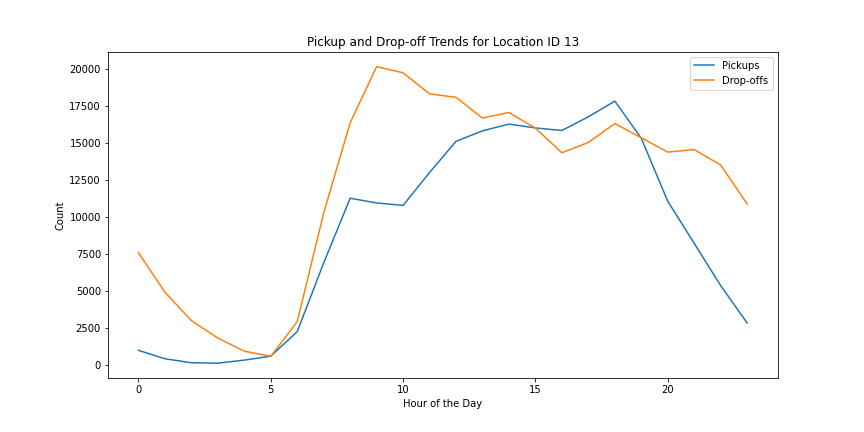
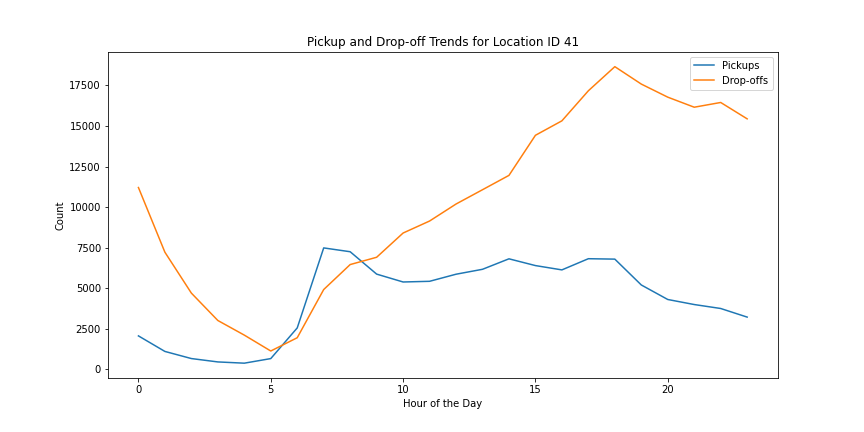
...
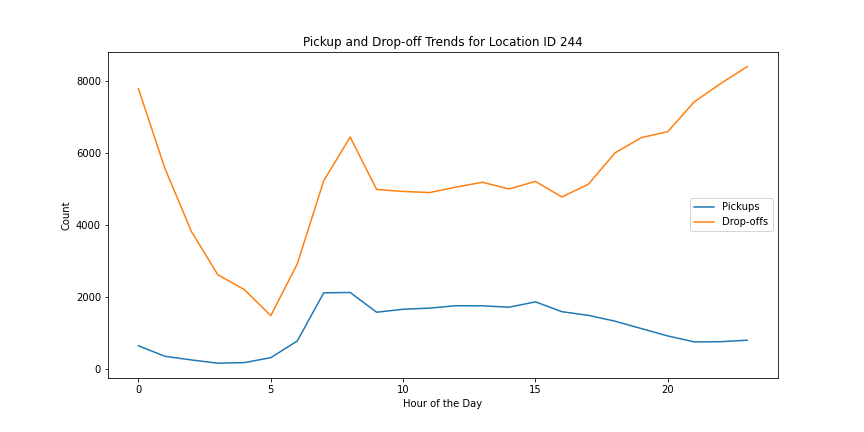
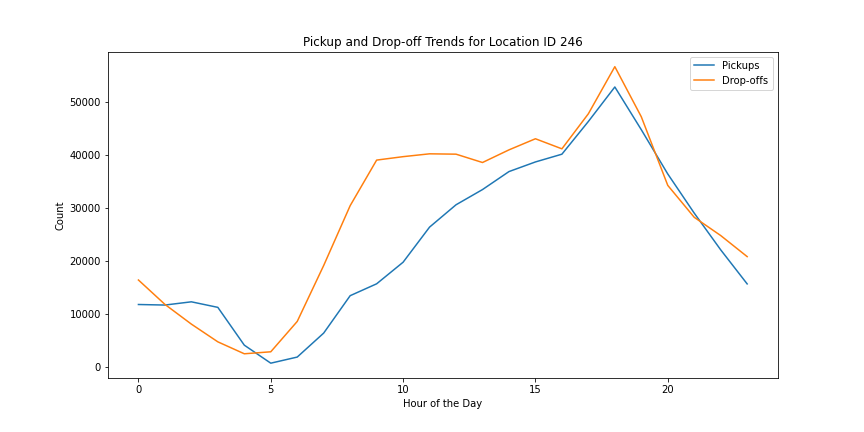
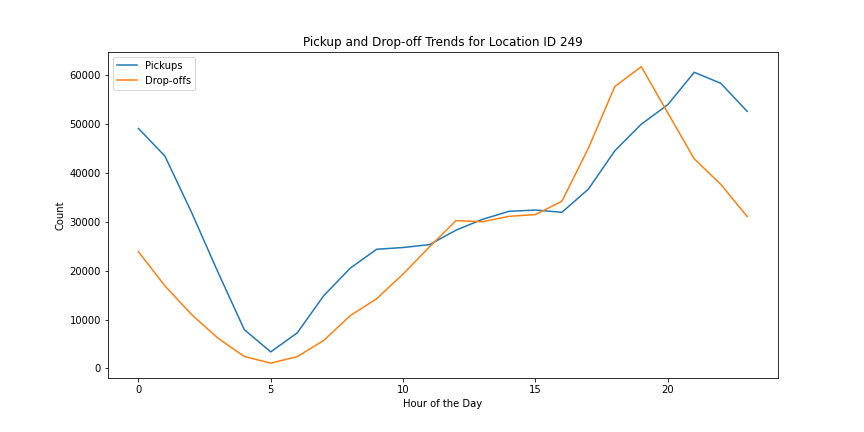
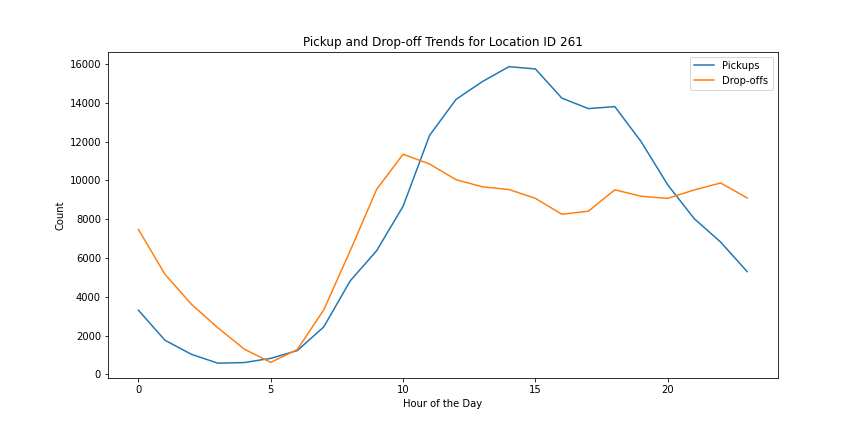
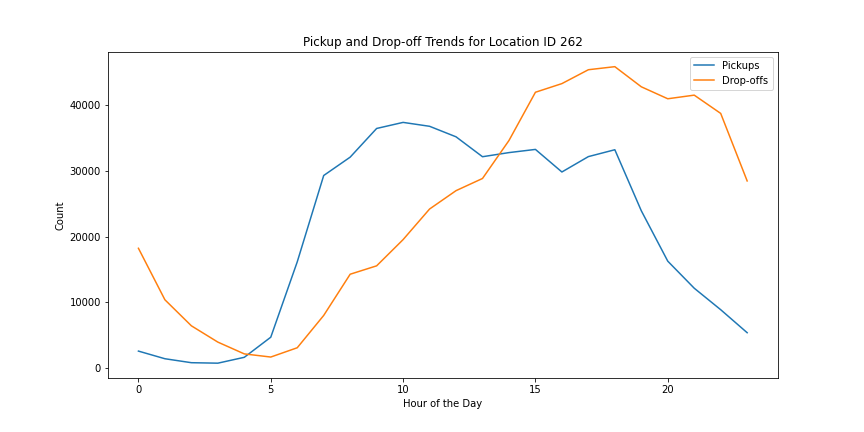

In [36]:
import os
import base64
import folium

# Function to create a popup with the image for a specific location_id
def create_popup_content(location_id):
    # Extract the numerical part of the location_id
    number_part = location_id.replace("PickupAndDropoffTrends_LocationID_", "")
    image_filename = f"PickupAndDropoffTrends_LocationID_{number_part}.png"  # Form the image filename
    image_path = os.path.join("/Users/saoirse/Documents/summerresearch/", image_filename)

    if os.path.exists(image_path):
        with open(image_path, "rb") as f:
            image_base64 = base64.b64encode(f.read()).decode("utf-8")
            # Combine the location ID and the image in the popup content
            popup_content = f'Location ID: {location_id}<br><img src="data:image/png;base64,{image_base64}" width="300px">'
    else:
        popup_content = f'Location ID: {location_id}<br>Image not found'
    
    return popup_content

# Create the map
m = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

# Filter the GeoJson features to only include Manhattan borough
filtered_features = [feature for feature in geo_json_data['features'] if feature['properties']['borough'] == 'Manhattan']

# Create a GeoJson object with the filtered data and add it to the map
g = folium.GeoJson(filtered_geo_json_data)

# Function to set the custom style and popup for each location_id when hovering over the location
def style_function(feature):
    location_id = feature['properties']['location_id']
    popup_content = create_popup_content(location_id)
    return {'fillOpacity': 0.6, 'popup': popup_content}

# Add the custom style and popup to the GeoJson layer
g.style_function = style_function

# Add the GeoJson object to the map
g.add_to(m)

# Loop through each filtered location and add markers with popups to the map
for feature in filtered_features:
    location_id = feature['properties']['location_id']
    coordinates = feature['geometry']['coordinates']

    # Helper function to extract latitude and longitude from nested coordinates
    def get_lat_lon(coord):
        if isinstance(coord[0], list):
            return get_lat_lon(coord[0])  # Continue nesting until we reach the point
        else:
            return coord[1], coord[0]  # Latitude, Longitude

    def get_center_lat_lon(coord):
        if isinstance(coord[0][0], list):
            return get_center_lat_lon(coord[0])  # Continue nesting until we reach the point
        else:
            lat_sum = sum(point[1] for point in coord)
            lon_sum = sum(point[0] for point in coord)
            return lat_sum / len(coord), lon_sum / len(coord)  # Center latitude, Center longitude

    center_lat, center_lon = get_center_lat_lon(coordinates)

    lat, lon = get_lat_lon(coordinates)

    popup_content = create_popup_content(location_id)
    popup = folium.Popup(popup_content, max_width=400)
    
    # Check if latitude and longitude are valid before adding the marker
    if lat is not None and lon is not None:
        folium.Marker(location=[center_lat, center_lon], icon=folium.Icon(color='blue'), popup=popup).add_to(m)

# Display the map
m

In [37]:
import pandas as pd
import pyarrow.parquet as pq

# Read the original Parquet file
table = pq.read_table('hourly.parquet')
df = table.to_pandas()

In [38]:
filtered_features = [feature for feature in geo_json_data['features'] if feature['properties']['borough'] == 'Manhattan']
# Extract the set of location_id values from the filtered GeoJSON data
manhattan_location_ids = set(feature['properties']['location_id'] for feature in filtered_features)

# Verify the contents of the manhattan_location_ids set
print(manhattan_location_ids)

{'194', '243', '249', '162', '13', '143', '128', '166', '233', '230', '202', '116', '152', '140', '88', '186', '87', '261', '24', '161', '163', '209', '236', '43', '142', '246', '125', '50', '107', '238', '144', '262', '75', '48', '127', '42', '41', '229', '231', '148', '263', '141', '79', '113', '68', '158', '234', '170', '237', '90', '103', '153', '164', '239', '232', '45', '114', '74', '12', '4', '120', '137', '100', '151', '224', '244', '211'}


In [39]:
# Filter the DataFrame based on matching PULocationID or DOLocationID
filtered_df = df[df['PULocationID'].isin(manhattan_location_ids) | df['DOLocationID'].isin(manhattan_location_ids)]

# Save the filtered DataFrame to a Parquet file
filtered_table = pa.Table.from_pandas(filtered_df)
pq.write_table(filtered_table, 'practice.parquet')

In [40]:
table = pq.read_table('practice.parquet')
df = table.to_pandas()

In [41]:
df2=pd.read_csv('mtavisualise.csv')

In [42]:

# Create a set to store unique latitude and longitude combinations
unique_locations = set()
# Create a dictionary to store location names based on lat, lon as key
location_names = {}

# Iterate over each row in df2 and add unique locations to the set
for _, row in df2.iterrows():
    lat = row['latitude']
    lon = row['longitude']
    location_name = row['station_complex']  # Assuming the column name containing location names is 'LocationName'
    unique_locations.add((lat, lon))
    location_names[(lat, lon)] = location_name

In [43]:
%store -r station_complex_images


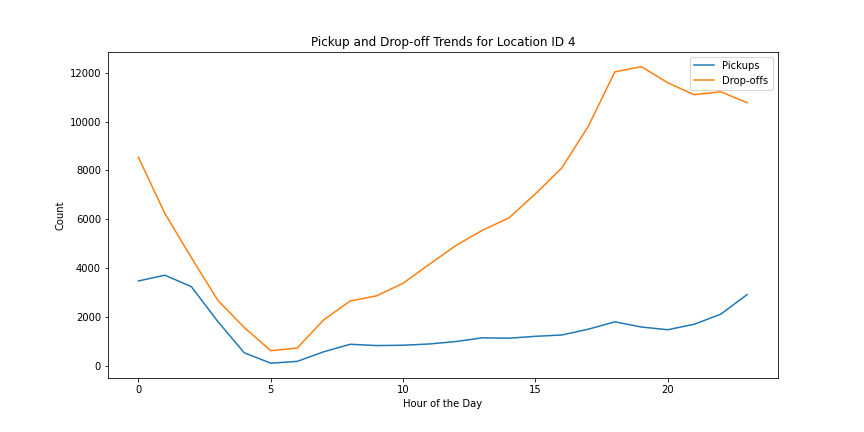
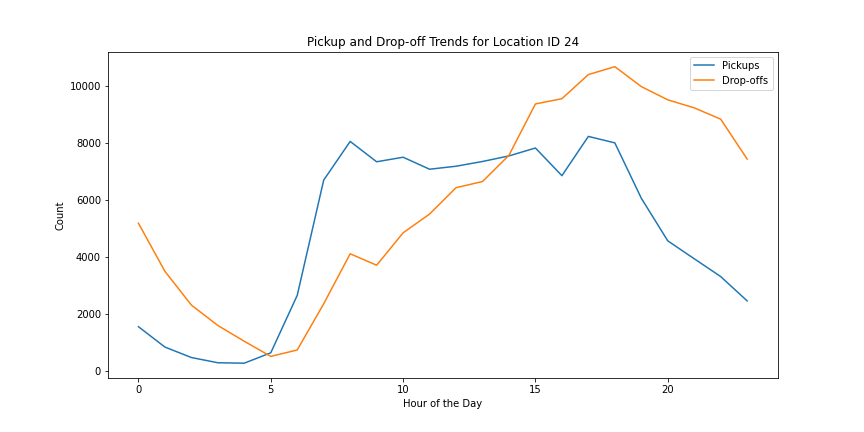
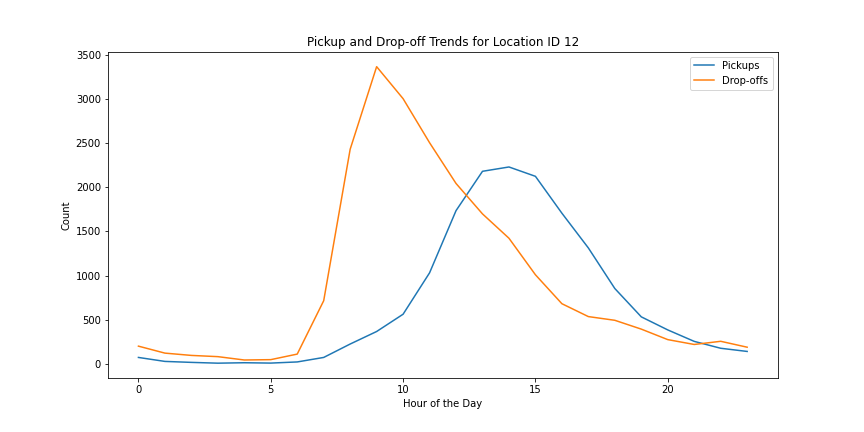
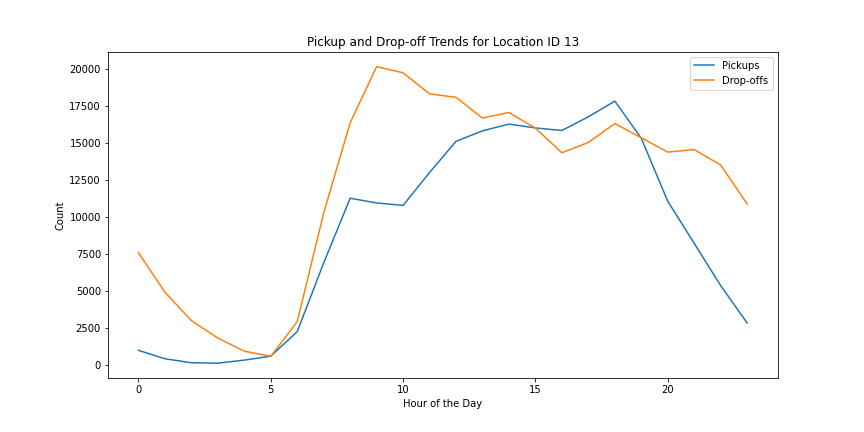
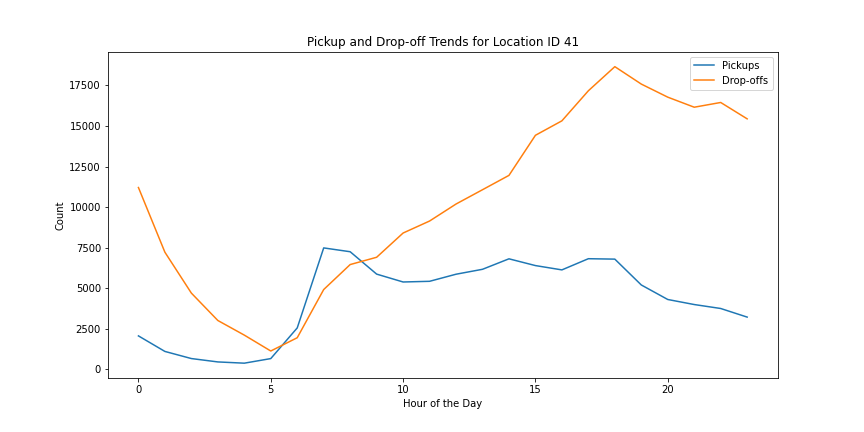
...
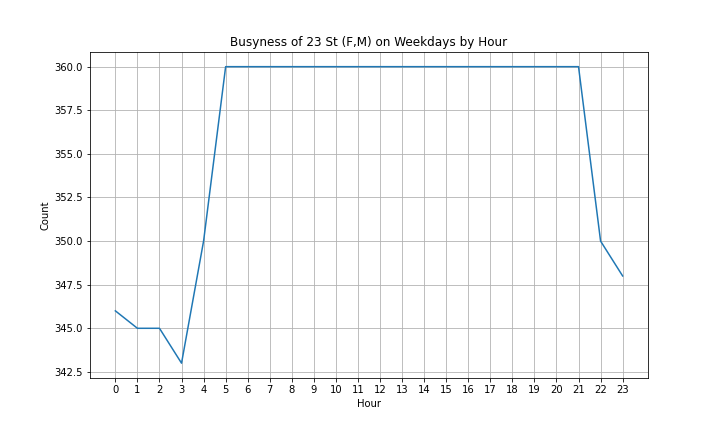
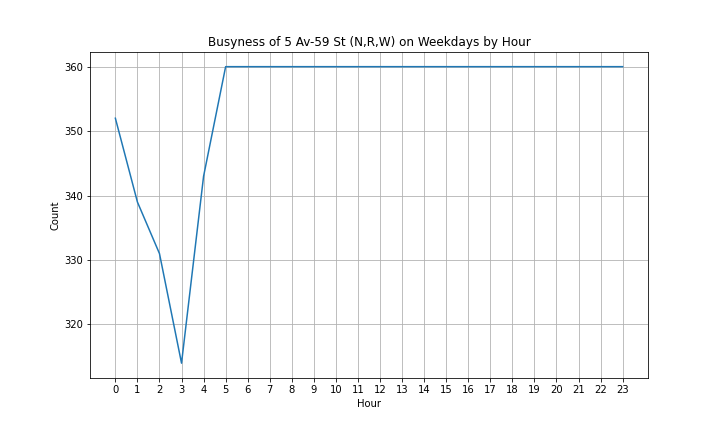
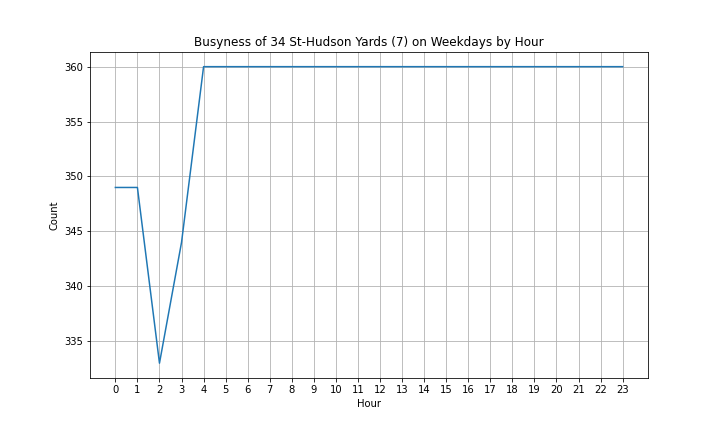
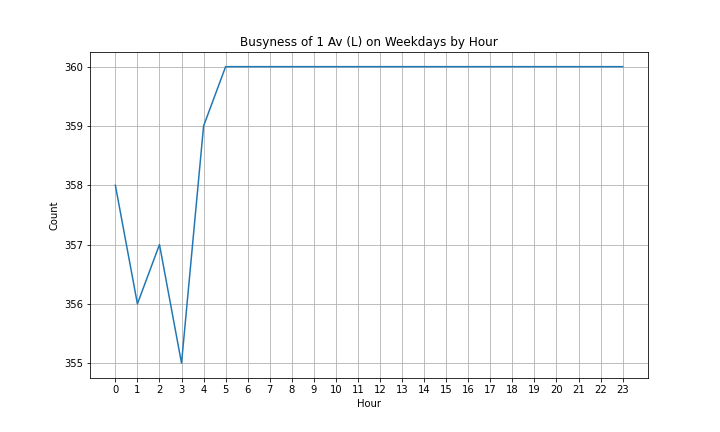
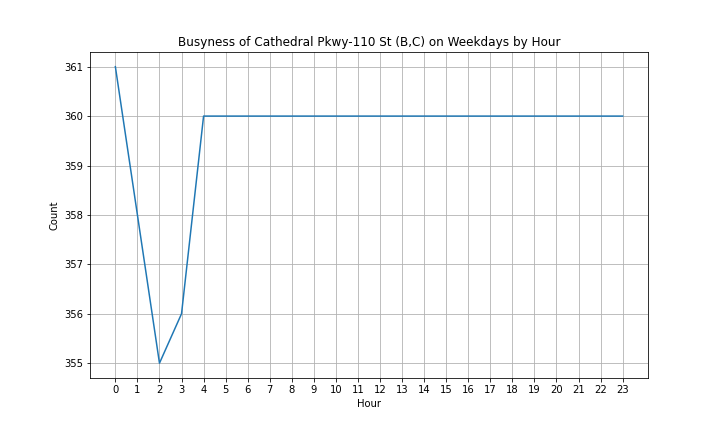

In [44]:
import os
import base64
import folium
small_icon = folium.Icon(color='blue', icon_size=(10, 10))  # Adjust the icon_size as needed

# Function to create a popup with the image for a specific location_id
def create_popup_content(location_id):
    # Extract the numerical part of the location_id
    number_part = location_id.replace("PickupAndDropoffTrends_LocationID_", "")
    image_filename = f"PickupAndDropoffTrends_LocationID_{number_part}.png"  # Form the image filename
    image_path = os.path.join("/Users/saoirse/Documents/summerresearch/", image_filename)

    if os.path.exists(image_path):
        with open(image_path, "rb") as f:
            image_base64 = base64.b64encode(f.read()).decode("utf-8")
            # Combine the location ID and the image in the popup content
            popup_content = f'Location ID: {location_id}<br><img src="data:image/png;base64,{image_base64}" width="300px">'
    else:
        popup_content = f'Location ID: {location_id}<br>Image not found'
    
    return popup_content

# Create the map
m = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

# Filter the GeoJson features to only include Manhattan borough
filtered_features = [feature for feature in geo_json_data['features'] if feature['properties']['borough'] == 'Manhattan']

# Create a GeoJson object with the filtered data and add it to the map
g = folium.GeoJson(filtered_geo_json_data)

# Function to set the custom style and popup for each location_id when hovering over the location
def style_function(feature):
    # location_id = feature['properties']['location_id']
    # popup_content = create_popup_content(location_id)
    return {'fillOpacity': 0.6, 'popup': popup_content}

# Add the custom style and popup to the GeoJson layer
g.style_function = style_function

# Add the GeoJson object to the map
g.add_to(m)

# Loop through each filtered location and add markers with popups to the map
for feature in filtered_features:
    location_id = feature['properties']['location_id']
    coordinates = feature['geometry']['coordinates']

    # Helper function to extract latitude and longitude from nested coordinates
    def get_lat_lon(coord):
        if isinstance(coord[0], list):
            return get_lat_lon(coord[0])  # Continue nesting until we reach the point
        else:
            return coord[1], coord[0]  # Latitude, Longitude

    def get_center_lat_lon(coord):
        if isinstance(coord[0][0], list):
            return get_center_lat_lon(coord[0])  # Continue nesting until we reach the point
        else:
            lat_sum = sum(point[1] for point in coord)
            lon_sum = sum(point[0] for point in coord)
            return lat_sum / len(coord), lon_sum / len(coord)  # Center latitude, Center longitude

    center_lat, center_lon = get_center_lat_lon(coordinates)

    lat, lon = get_lat_lon(coordinates)

    popup_content = create_popup_content(location_id)
    popup = folium.Popup(popup_content, max_width=400)
    
    # Check if latitude and longitude are valid before adding the marker
    if lat is not None and lon is not None:
        folium.Marker(location=[center_lat, center_lon], icon=folium.Icon(color='blue'), popup=popup).add_to(m)

# Specify the width for the images in the popups
image_width = 300
# Iterate over each row in the DataFrame for the main map
for _, row in df.iterrows():
    # Extract the pickup and dropoff location IDs
    pickup_location_id = row['PULocationID']
    dropoff_location_id = row['DOLocationID']

    # Find the corresponding pickup and dropoff coordinates in the GeoJSON data
    pickup_coordinates = None
    dropoff_coordinates = None

    for feature in geo_json_data['features']:
        if feature['properties']['location_id'] == pickup_location_id:
            pickup_coordinates = feature['geometry']['coordinates']
        elif feature['properties']['location_id'] == dropoff_location_id:
            dropoff_coordinates = feature['geometry']['coordinates']

    # Add unique pickup and dropoff locations to the set
    if pickup_coordinates:
        unique_locations.add((pickup_coordinates[1], pickup_coordinates[0]))
    if dropoff_coordinates:
        unique_locations.add((dropoff_coordinates[1], dropoff_coordinates[0]))

# Add markers for unique locations to the main map
for lat, lon in unique_locations:
    location_name = location_names[(lat, lon)]  # Get the location name from the dictionary
    # Get the base64 encoded image from the 'station_complex_images' dictionary
    image_base64 = station_complex_images[location_name]
    # Construct the popup content with the base64 encoded image and set the image width
    popup_content = f'<img src="data:image/png;base64,{image_base64}" alt="Graph" width="{image_width}px">{location_name}'

    folium.Marker(location=[lat, lon],
                  icon=folium.Icon(color='green'),
                  popup=popup_content).add_to(m)  # Use the location name as the popup content

# Display the map
m